In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import numpy as np
from pylab import rcParams
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

%matplotlib inline

In [75]:
sns.set(style="ticks")
sns.set_style("whitegrid")
rcParams['figure.dpi'] = 350
rcParams['lines.linewidth'] = 2
rcParams['axes.facecolor'] = 'white'
rcParams['patch.edgecolor'] = 'white'
rcParams['font.family'] = 'StixGeneral'
rcParams['figure.figsize'] = 15,10
rcParams['font.size'] = 20
rcParams['axes.labelsize'] = 'large'
rcParams['xtick.labelsize'] = 16
rcParams['ytick.labelsize'] = 16

In [4]:
import os
import sys
import gzip
import json
import nltk
from nltk import clean_html
from textblob import TextBlob, Word
from gensim.models import Word2Vec
from gensim import corpora, models, similarities

#!pip install gensim
from sklearn.manifold import TSNE
from nltk.corpus import stopwords
stopwords = stopwords.words('english')

E:\Anaconda\lib\site-packages\gensim\utils.py:1212: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


In [5]:
# import our intents file
import json
def getdata(path):
    g = open(path,'r')
    for l in g:
        yield eval(l)
intents = list(getdata('datasets/QA_Video_Games.json'))

In [6]:
stop_words = nltk.corpus.stopwords.words('english') + [
    '.',    
    ',',
    '#',
    '@',
    '$',
    '%',
    '&',
    '--',
    '\'s',
    '?',
    ')',
    '(',
    '\'',
    '\'\'',
    '\'re',
    '"',
    '-',
    '}',
    '{',
    '!',
    u'—',
    ''
]

In [7]:
qa_df = pd.DataFrame(columns=['asin', 'q_type', 'q_text', 'a_text', 'a_help'])
# loop through each question in our intents
index = 0
for intent in intents:
    asin = intent['asin']
    qObj = {}   
    for question in intent['questions']:
        aObj = {}
        aObj['helpful'] = -1
        for answer in question['answers']:
            #print (answer['helpful'])
            t = answer['helpful']
            if (t[0]+t[1] > aObj['helpful']):
                aObj['helpful'] = t[0]+t[1]
                aObj['a_text'] = answer['answerText']
        qa_df.loc[index] = [asin, question['questionType'], question['questionText'], aObj['a_text'], aObj['helpful']]
        index = index+1
qa_df.head()    

,asin,q_type,q_text,a_text,a_help
0,B0000512IE,open-ended,Can I use these with Window 8/8.1?,"Yes, you will need to go to their website to d...",4
1,B0000512IE,open-ended,Could this be adapted to be used in racing gam...,I googled the question and found many forums o...,0
2,B0000512IE,open-ended,How far are the pedals apart? i.e. the spacing...,4 inches. They are also at an awkward angle wh...,4
3,B0000512IE,open-ended,Is there any adjustment in sensitivity of the ...,I don't think so. My son and husband use this...,2
4,B0000512IE,yes/no,"does anyone use them for Star Citizen, and if ...",Yep. They're a bit small and certainly take so...,2


##### How many questions raised for each products?

In [8]:
grouped_by_asin = qa_df.groupby('asin')
grouped_by_asin = pd.DataFrame({'asin': grouped_by_asin.size().index, 'count': grouped_by_asin.size().values})
grouped_by_asin.sort_values(by='count', ascending=False)
grouped_by_asin['count'].unique()

array([ 4, 10,  5,  3,  9,  7,  8,  6,  1,  2], dtype=int64)

##### There are at most 10 questions and at least 1 questions for all the products, let's check the products numbers for each number of question

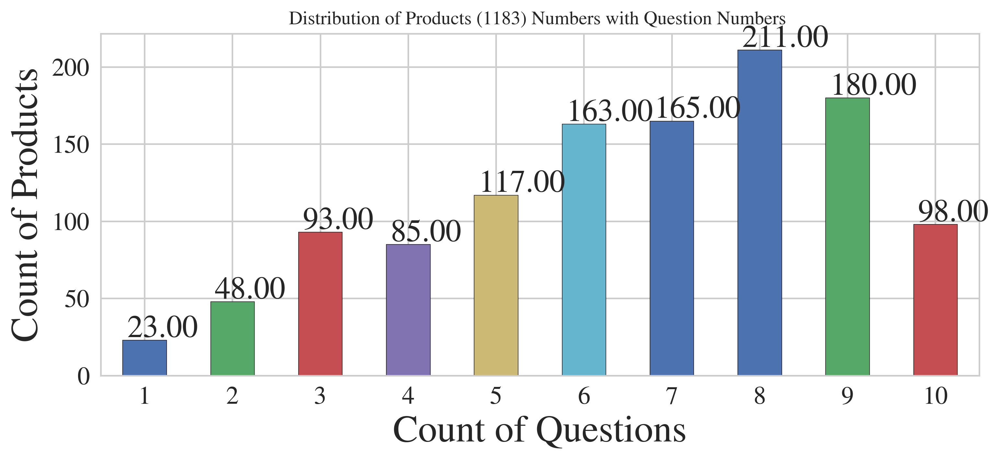

In [77]:
df_asin_count = grouped_by_asin.groupby('count')
df_asin_count = pd.DataFrame({'Questions': df_asin_count.size().index, 'Products': df_asin_count.size().values})
df_asin_count.sort_values(by='Questions')
df_asin_count.head()

ax = df_asin_count.plot(kind='bar', x='Questions', y='Products', rot=0, edgecolor='k', legend=False, figsize=(10,4))
plt.xlabel('Count of Questions'); 
plt.ylabel('Count of Products');
plt.title('Distribution of Products (%d) Numbers with Question Numbers '%(len(grouped_by_asin)))
for p in ax.patches:
    b = p.get_bbox()
    val = "{:.2f}".format(b.y1 + b.y0)        
    ax.annotate(val, ((b.x0 + b.x1)/2-0.2, b.y1+2))

##### Show the questions and answers length distribution

The shortest and longest questions are 2 and 2478
The shortest and longest answers are 1 and 7026


E:\Anaconda\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
E:\Anaconda\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


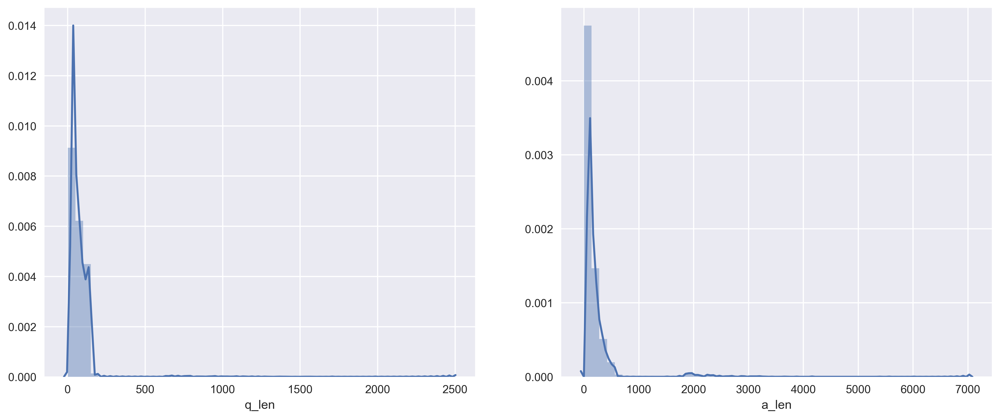

In [14]:
qa_df['q_len'] = qa_df[['q_text']].applymap(len)
qa_df['a_len'] = qa_df[['a_text']].applymap(len)
print('The shortest and longest questions are {} and {}'.format(qa_df['q_len'].min(), qa_df['q_len'].max()))
print('The shortest and longest answers are {} and {}'.format(qa_df['a_len'].min(), qa_df['a_len'].max()))

sns.set(rc={'figure.figsize':(15, 6)})

q_ax = plt.subplot(1, 2, 1)
sns.distplot(qa_df['q_len'], ax=q_ax)
a_ax = plt.subplot(1, 2, 2)
sns.distplot(qa_df['a_len'], ax=a_ax);

plt.show()

## Sentiment Analysis with TextBlob

In [15]:
from textblob.sentiments import NaiveBayesAnalyzer, PatternAnalyzer
from textblob import Blobber
from textblob.classifiers import NaiveBayesClassifier
tba = Blobber(analyzer=NaiveBayesAnalyzer())

Text(0.5,1,'Sentiment plot for answer on subjective analysis')

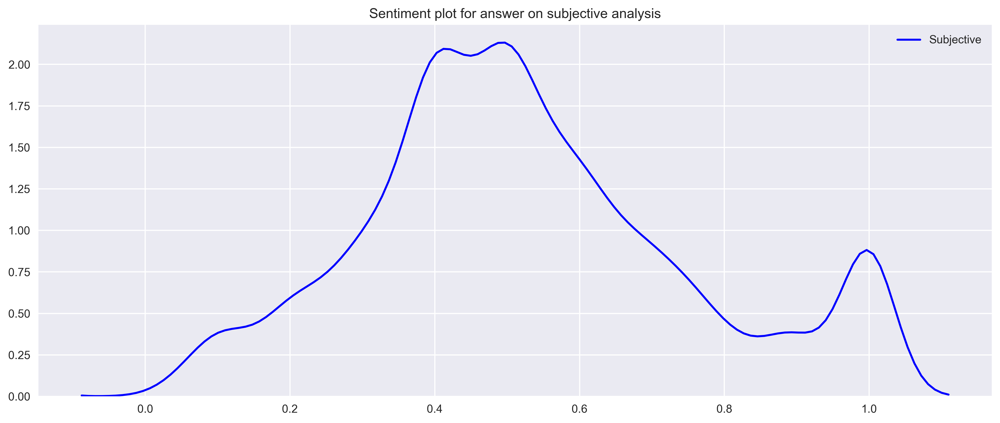

In [17]:
#Sentiment plot
def checkSemtiment(text):
    pos = []
    for i in text: 
        tmd = TextBlob(i).sentiment.subjectivity
        if tmd > 0:
            pos.append(tmd)
    return pos

#get result
result_sem = checkSemtiment(qa_df['a_text'])
subjective = pd.DataFrame(result_sem, columns=['answer_subjective']) 

#plot subjective
sns.kdeplot(subjective['answer_subjective'],color='blue', label='Subjective')
plt.title('Sentiment plot for answer on subjective analysis')

In [18]:
result_sem = checkSemtiment(qa_df['a_text'])

In [19]:
#get question result
result_sem_qs = checkSemtiment(qa_df['q_text'])
subjective_qs = pd.DataFrame(result_sem_qs, columns=['question_subjective']) 

Text(0.5,1,'Sentiment plot for question on subjective analysis')

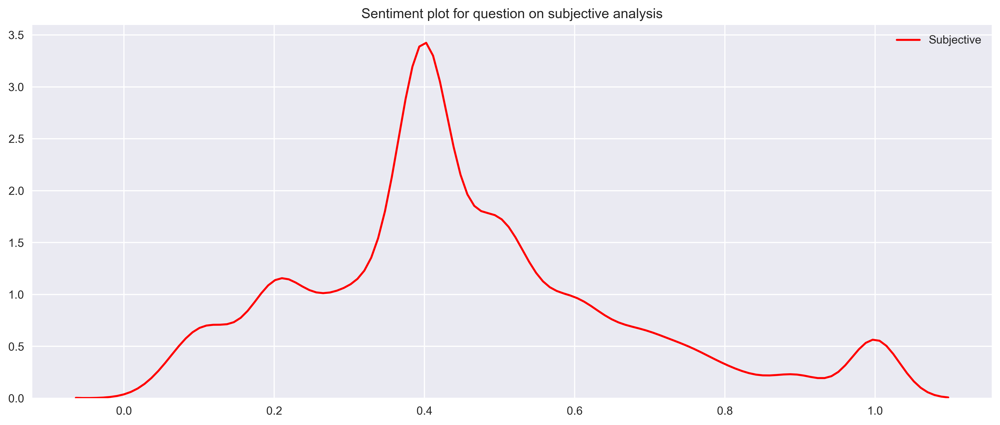

In [20]:
#plot objective and subjective
sns.kdeplot(subjective_qs['question_subjective'],color='red', label='Subjective')
plt.title('Sentiment plot for question on subjective analysis')

### Map question type

In [21]:
q_a = qa_df[['asin','q_type','q_text','a_text']]

In [22]:
mapping = {"yes/no": 1, "open-ended": 0}
q_a['q_type'] = q_a['q_type'].replace(mapping).astype(np.int)
q_a.head()

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,asin,q_type,q_text,a_text
0,B0000512IE,0,Can I use these with Window 8/8.1?,"Yes, you will need to go to their website to d..."
1,B0000512IE,0,Could this be adapted to be used in racing gam...,I googled the question and found many forums o...
2,B0000512IE,0,How far are the pedals apart? i.e. the spacing...,4 inches. They are also at an awkward angle wh...
3,B0000512IE,0,Is there any adjustment in sensitivity of the ...,I don't think so. My son and husband use this...
4,B0000512IE,1,"does anyone use them for Star Citizen, and if ...",Yep. They're a bit small and certainly take so...


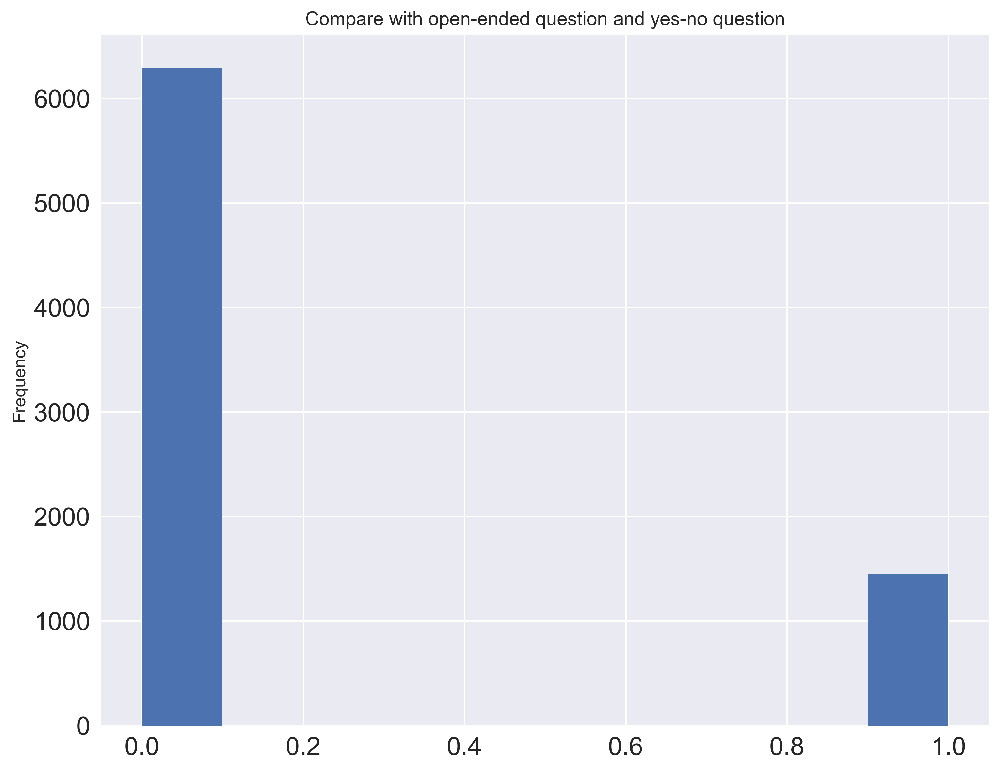

In [23]:
YandN = q_a.loc[q_a['q_type']== 1]
opt = q_a.loc[q_a['q_type']== 0]
opt_numb = opt.count()
YandN_numb = YandN.count()
q_a['q_type'].plot(kind='hist', title='Compare with open-ended question and yes-no question', figsize=(10, 8), fontsize='16')

##### Tokenize words and get similarity

In [24]:
def sentence_words_mapper(s):
    tmpWords = nltk.word_tokenize(s)
    return [w.lower() for w in tmpWords if w.lower() not in stop_words]
    
# quesiton is like ['B0000512IE', 'May I use this in racing games also?']
def find_answer(q):
    k_df = qa_df[qa_df.asin == q[0]]
    k_df['q_text'] = k_df[['q_text']].applymap(sentence_words_mapper)
    
    q_base = k_df.q_text.values.tolist()
    dictionary = corpora.Dictionary(q_base)
    corpus = [dictionary.doc2bow(text) for text in q_base]
    lsi_model = models.LsiModel(corpus, id2word=dictionary)
    q_words = sentence_words_mapper(q[1])
    vec_bow = dictionary.doc2bow(q_words)
    vec_lsi = lsi_model[vec_bow] 
    index = similarities.MatrixSimilarity(lsi_model[corpus]) 
    sims = index[vec_lsi]
    a_index = -1
    max_prob = 0
    for i in range(len(sims)):
        if (sims[i] > max_prob):
            max_prob = sims[i]
            a_index = i

    return (k_df.loc[a_index].a_text)

In [25]:
print (find_answer(['B0000512IE', 'May I use this in racing games also?']))

I googled the question and found many forums of users using both the CH yoke and pedals for racing games. So yes they can be use for racing. - Dave


E:\Anaconda\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


### Word2Vec

In [26]:
# delete number and symbol
import string
def CleanLines(text):
    cleanLine = []
    #identify = string.maketrans('', '')
    #identify = str.maketrans('', '')
    delEStr = string.punctuation +string.digits
    table = str.maketrans('','',delEStr)
    
    for i in text:       
        #lines = i.translate(identify,delEStr)
        lines = i.translate(table)
        cleanLine.append(lines) 
    return cleanLine
    

In [27]:
t_answer = CleanLines(q_a['a_text'])

In [28]:
#add token in answer question
def getToken(text):
    token_as = []
    for i in text:
        tokens = tokenizer.tokenize(i)
        token_as.append(tokens)
    #return token_as
    return token_as

In [30]:
from nltk.tokenize import RegexpTokenizer
#w means tokens are made of only alphanumeric characters where + indicates that they comprise of one or more of such characters
tokenizer = RegexpTokenizer('\w+')
t_answer = getToken(t_answer)

In [31]:
#delete stop words and make lowercase ?? not lower
def cleanword(text):
    stop_w = []
    for e in text:
        content = [w.lower() for w in e if w.lower() not in stopwords]
        stop_w.append(content)
    return stop_w

In [47]:
t_answer = cleanword(t_answer)

In [33]:
model = Word2Vec(t_answer, sg=1, size=100,  window=5,  min_count=5,  negative=3, sample=0.001, hs=1, workers=5)
model.save('../Question_Answering/datasets/application_a.bin')

In [34]:
model = Word2Vec.load('../Question_Answering/datasets/application_a.bin')

In [35]:
model['computer'] 

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


array([-0.04649531, -0.38484588,  0.63560146,  0.01619305,  0.44826666,
       -0.29463914, -0.19494937,  0.07132258,  0.3154434 , -0.10376959,
       -0.6696696 , -0.53347754,  0.41844863, -0.38821292, -0.33334416,
        0.34219864,  0.36887333,  0.09065767,  0.13808714,  0.16502623,
        0.03470774,  0.08601598, -0.33655512,  0.08497317, -0.10147014,
       -0.10892876,  0.22661155,  0.52889764,  0.5279561 ,  0.374754  ,
       -0.37952593, -0.01762203,  0.3363534 ,  0.2828262 ,  0.0725769 ,
       -0.03794576, -0.1775128 , -0.18822423, -0.3116039 , -0.12885545,
        0.2947301 ,  0.07199319, -0.39417034, -0.01742524, -0.21130852,
        0.15077782,  0.20136738, -0.10268327, -0.05580491, -0.06625195,
        0.49423188,  0.14315817, -0.36148164,  0.04280431,  0.2396248 ,
       -0.634692  ,  0.41638008, -0.28055564, -0.2452701 ,  0.07599142,
        0.26813772, -0.19110815,  0.04563037, -0.29429635, -0.3205038 ,
        0.11706598, -0.02211842,  0.25460544, -0.2752615 , -0.35

In [37]:
model.similarity('computer', 'phone')

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similarity` (Method will be removed in 4.0.0, use self.wv.similarity() instead).
  """Entry point for launching an IPython kernel.


0.4279517

### Model Virtualization

In [43]:
def tsne_plot(model):
    "Creates and TSNE model and plots it"
    labels = []
    tokens = []

    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(16, 16)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


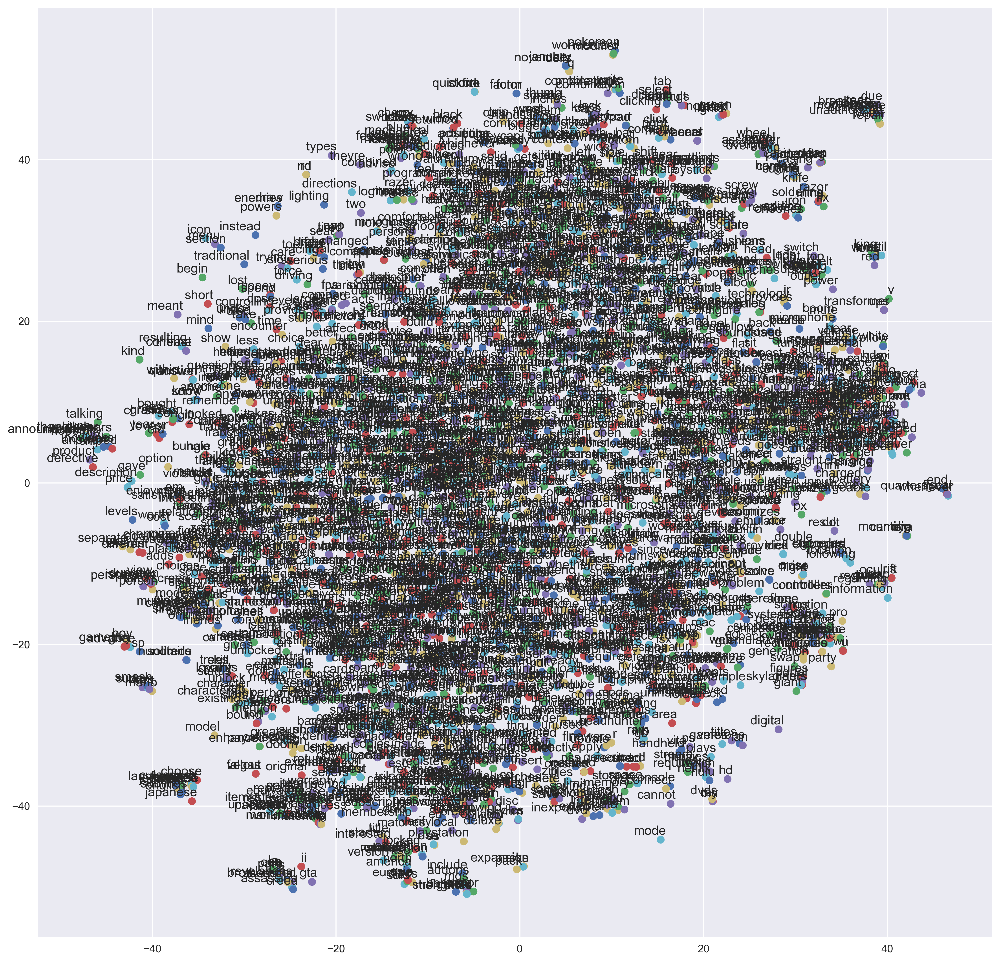

In [44]:
tsne_plot(model)

### Model parameter adjustment

In [58]:
t_question = CleanLines(q_a['q_text'])
t_question = getToken(t_question)

In [60]:
model_aj = Word2Vec(t_question, sg=1, size=100,  window=5,  min_count=5,  negative=3, sample=0.001, hs=1, workers=5)
#model_aj.save('../Question_Answering/datasets/application_aj.bin')

In [61]:
def tsne_plot(model):
    "Creates and TSNE model and plots it"
    labels = []
    tokens = []

    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(16, 16)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


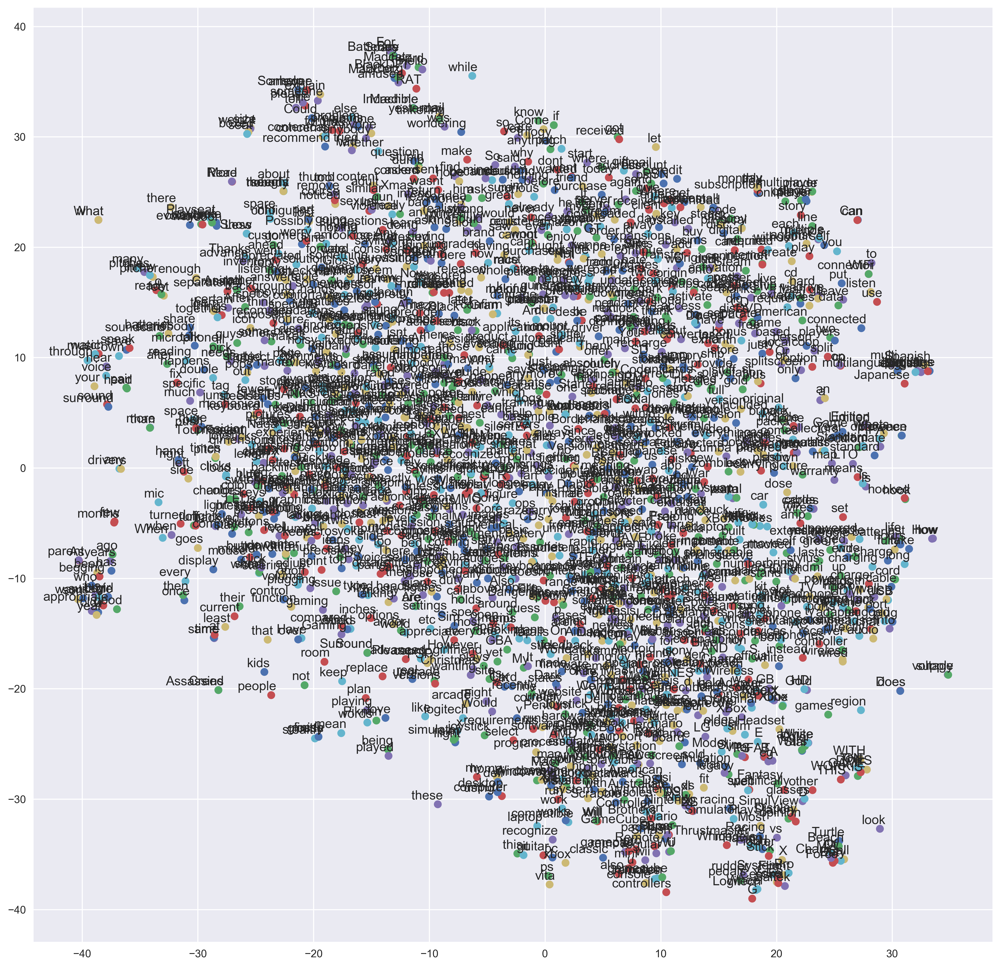

In [62]:
tsne_plot(model_aj)

### Sample for similar word of computer

In [65]:
#Get similartity words of computer
ts = model.wv.similar_by_vector('computer')

#Create tokens and labels list
labels_computer = []
tokens_computer = []
location = model['computer'] 
for word in ts:
    tokens_computer.append(model[word[0]])
    tokens_computer.append(location)
    labels_computer.append(word[0])
    labels_computer.append('computer')
#Dimention vectors
tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
new_values = tsne_model.fit_transform(tokens_computer) 

E:\Anaconda\lib\site-packages\ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
E:\Anaconda\lib\site-packages\ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':


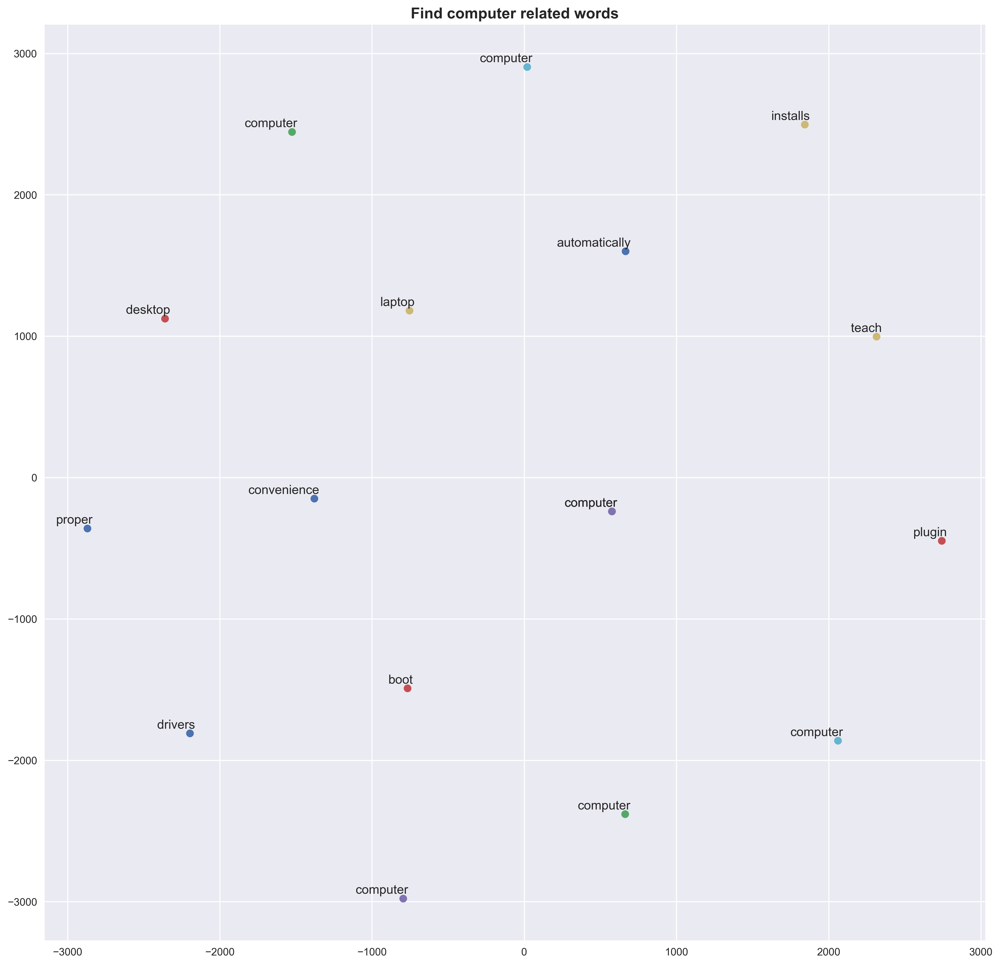

In [41]:
#Create axis for vectprs
x = []
y = []
for value in new_values:
    x.append(value[0])
    y.append(value[1])
        
plt.figure(figsize=(16, 16)) 
for i in range(len(x)):
    plt.scatter(x[i],y[i])
    plt.annotate(labels_phone[i],
         xy=(x[i], y[i]),
         xytext=(5, 2),
         textcoords='offset points',
         ha='right',
         va='bottom')

plt.title('Find computer related words', fontsize='large', fontweight='bold')    
plt.show()

In [67]:
from mpl_toolkits.mplot3d import Axes3D
tsne = TSNE(n_components=3, random_state=0, n_iter=10000, perplexity=2)
np.set_printoptions(suppress=True)
T = tsne.fit_transform(tokens_computer)
labels = labels_computer

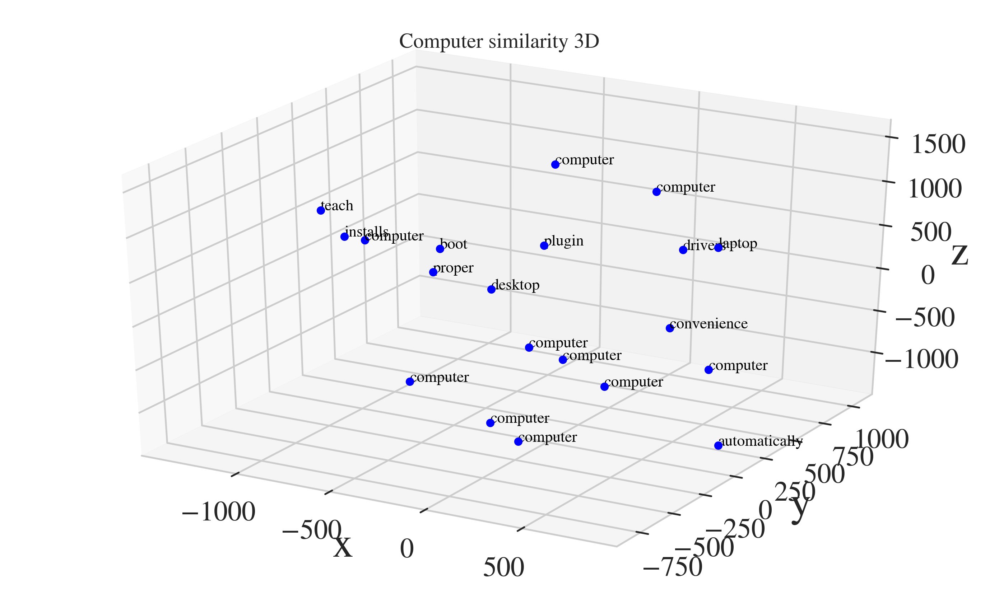

In [78]:
plt.figure(figsize=(10, 6))
ax = plt.subplot(111,projection='3d')

for i in range(len(T)): # plot each point + it's index as text above
    x = T[i,0]
    y = T[i,1]
    z = T[i,2]
    label = labels[i]
    ax.scatter(x, y, z, color='b');
    ax.text(x, y, z, '%s' % (label), size=9, zorder=1, color='k');

ax.set_title('Computer similarity 3D');
ax.set_xlabel('x');
ax.set_ylabel('y');
ax.set_zlabel('z');